In [1]:
import numpy as np
import pandas as pd
import plotly.express as px
import plotly.io as pio
import json
import requests

In [45]:
pd.options.plotting.backend = "plotly"
pio.templates.default = "plotly_white"

global_dict = json.loads(requests.get('https://raw.githubusercontent.com/southkorea/southkorea-maps/master/kostat/2018/json/skorea-provinces-2018-geo.json').text)
local_dict = json.loads(requests.get('https://raw.githubusercontent.com/southkorea/southkorea-maps/master/kostat/2018/json/skorea-municipalities-2018-geo.json').text)
#--#
url = 'https://raw.githubusercontent.com/guebin/DV2022/main/posts/Energy/{}.csv'
prov = ['Seoul', 'Busan', 'Daegu', 'Incheon', 
        'Gwangju', 'Daejeon', 'Ulsan', 'Sejongsi', 
        'Gyeonggi-do', 'Gangwon-do', 'Chungcheongbuk-do', 
        'Chungcheongnam-do', 'Jeollabuk-do', 'Jeollanam-do', 
        'Gyeongsangbuk-do', 'Gyeongsangnam-do', 'Jeju-do']
df = pd.concat([pd.read_csv(url.format(p+y)).assign(년도=y, 시도=p) for p in prov for y in ['2018', '2019', '2020', '2021']]).reset_index(drop=True)\
.assign(년도 = lambda df: df.년도.astype(int))\
.set_index(['년도','시도','지역']).applymap(lambda x: int(str(x).replace(',','')))\
.reset_index()
df_global = pd.DataFrame([l['properties'] for l in global_dict['features']])
df_local = pd.DataFrame([l['properties'] for l in local_dict['features']])
df_json = df_local.set_index('name')\
.rename(
    {name:name.split('시')[-1] for name in df_local['name'] if ('시' in name) and ('구' in name) and (len(name)>3)}
).reset_index()\
.drop(['base_year','name_eng'],axis=1)\
.rename({'name':'name_local','code':'code_local'},axis=1)\
.assign(code = lambda df: df['code_local'].str[:2])\
.merge(df_global.drop(['base_year','name_eng'],axis=1))
df_left = df.assign(
    시도 = lambda df: df.시도.map({l['properties']['name_eng']:l['properties']['name'] for l in global_dict['features']})
).assign(on = lambda df: df.시도 + '-' + df.지역)
df_right = df_json.assign(on = lambda df: df.name + '-' + df.name_local)\
.drop(['name_local','name'],axis=1)
df2 = df_left.merge(
    df_right.set_index('on')\
    .rename({'인천광역시-남구':'인천광역시-미추홀구'})\
    .reset_index()
).drop(['on'],axis=1)

/tmp/ipykernel_1804/1368338306.py:15: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.



# 데이터탐색

In [46]:
#| title: 에너지사용량 자료 
#!pip install itables
import itables 
itables.show(df2,showIndex=False)


# 2. 에너지 사용량(지리정보시각화)-50점

## (1) 에너지사용량차이(전기-도시가스)시각화-25점

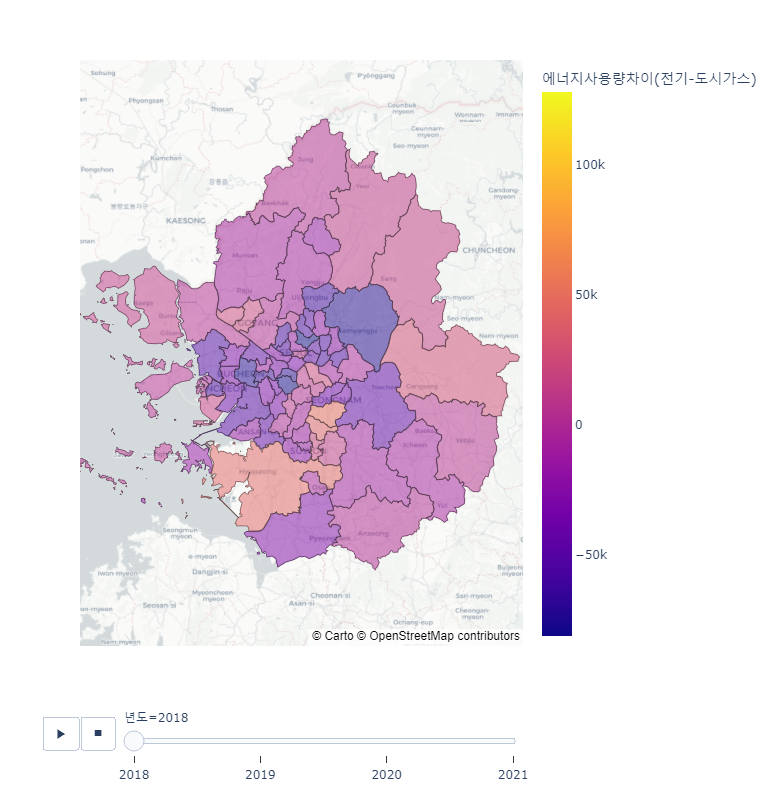

In [79]:
# 수도권 지역 선택
sudogwon_dict = local_dict.copy()
sudogwon_dict['features'] = [l for l in sudogwon_dict['features'] if l['properties']['code'][:2] in ['11', '23', '31']]

# 에너지사용량차이(전기-도시가스) 열 추가
df2['에너지사용량차이(전기-도시가스)'] = df2['에너지사용량(TOE)/전기'] - df2['에너지사용량(TOE)/도시가스']


# 시각화
fig = px.choropleth_mapbox(
    geojson=sudogwon_dict,
    featureidkey='properties.code',
    data_frame=df2,
    locations='code_local',
    color='에너지사용량차이(전기-도시가스)',
    animation_frame='년도',
    hover_data=['시도', '지역'],
    opacity=0.5,
    #---#
    mapbox_style="carto-positron",
    range_color=[df2['에너지사용량차이(전기-도시가스)'].min(), df2['에너지사용량차이(전기-도시가스)'].max()],
    center={"lat": 37.5642135, "lon": 127.0016985},
    zoom=7.5,
    height=800,
    width=750,
)
fig.show(config={'scrollZoom': False})


In [58]:
df2[df2['지역'] == '김포시']

,년도,시도,지역,건물동수,연면적,에너지사용량(TOE)/전기,에너지사용량(TOE)/도시가스,에너지사용량(TOE)/지역난방,code_local,code,에너지사용량차이(전기-도시가스),에너지사용량합계,에너지사용량합계(서울+김포),에너지사용비율
432,2018,경기도,김포시,15415,16499016,75482,72267,38969,31230,31,3215,186718,5600005.0,0.033342
433,2019,경기도,김포시,16038,17063243,76800,72793,38566,31230,31,4007,188159,5361143.0,0.035097
434,2020,경기도,김포시,16243,17534638,78417,75329,39953,31230,31,3088,193699,5302924.0,0.036527
435,2021,경기도,김포시,16661,18992098,83249,79763,44156,31230,31,3486,207168,7857412.0,0.026366


## (2) (서울+김포)특별시? - 25점

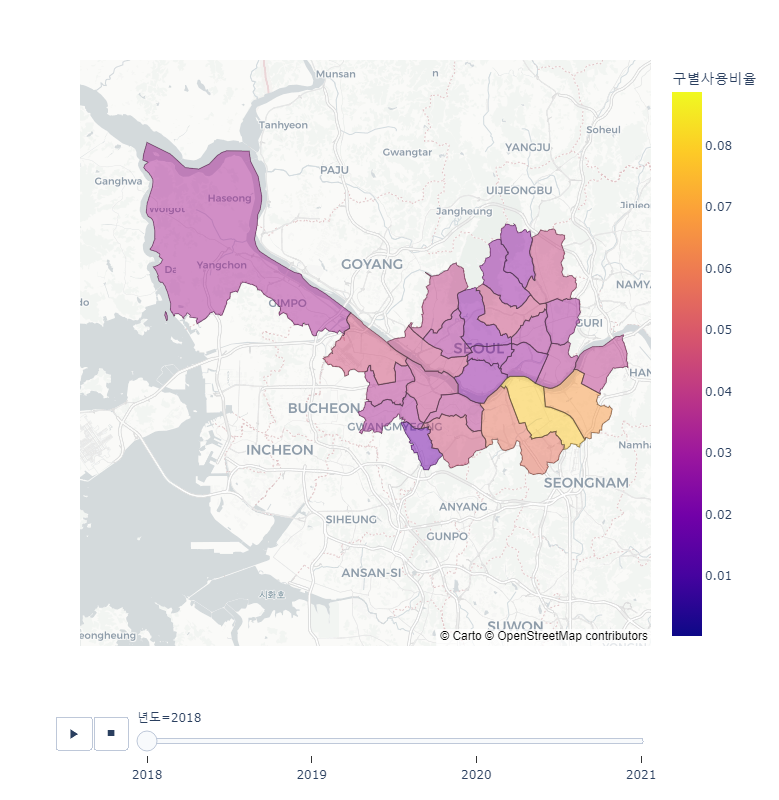

In [81]:
# 서울시와 김포시의 에너지 사용량 계산
seoul_energy = df2[df2['시도'] == '서울특별시'].groupby('년도')['에너지사용량합계'].sum()
kimpo_energy = df2[df2['지역'] == '김포시'].groupby('년도')['에너지사용량합계'].sum()

# 년도별 에너지 사용량 합계 계산
total_energy = seoul_energy.add(kimpo_energy, fill_value=0)

# 각 구별 에너지 사용 비율 계산
df2['구별사용비율'] = df2.apply(lambda row: row['에너지사용량합계'] / total_energy.loc[row['년도']], axis=1)

# 서울+김포 특별시 지리 정보 선택
seoul_kimpo_dict = local_dict.copy()
seoul_kimpo_dict['features'] = [l for l in seoul_kimpo_dict['features'] if l['properties']['code'][:2] == '11' or (l['properties']['code'][:2] == '31' and l['properties']['name'] == '김포시')]

# 시각화
fig = px.choropleth_mapbox(
    geojson=seoul_kimpo_dict,
    featureidkey='properties.code',
    data_frame=df2[(df2['시도'] == '서울특별시') | ((df2['시도'] == '경기도') & (df2['지역'] == '김포시'))],
    locations='code_local',
    color='구별사용비율',
    animation_frame='년도',
    hover_data=['시도', '지역'],
    opacity=0.5,
    #---#
    mapbox_style="carto-positron",
    range_color=[df2['구별사용비율'].min(), df2['구별사용비율'].max()],
    center={"lat": 37.5612, "lon": 126.8228},
    zoom=9,
    height=800,
    width=750,
)
fig.show(config={'scrollZoom': False})
